In [3]:
from ts2vg import NaturalVG
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
from community import community_louvain
from collections import Counter
from rqa_utils import scale_lc
from pyunicorn.timeseries import RecurrencePlot
from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('svg')

In [5]:
rp = np.load('../data/1ES_supremum_local_RR_0.05_recurrence_matrix.npy')
dho_rp = np.load('../data/1ES_DHO_supremum_local_RR_0.05_recurrence_matrix.npy')

df = pd.read_csv('1ES_binned_lc.csv')
pred_df = pd.read_csv('1ES_pred_DHO_lc.csv')

from networks import get_recurrence_network
G, DHO_G = get_recurrence_network(rp), get_recurrence_network(dho_rp)

Interpreting the recurrent network visualized with the Kamada layout, where the color coding signifies node degree, provides a compelling overview of the complex interactions within the CL AGN X-ray variability. Regions with higher degrees (warmer colors) suggest periods of heightened connectivity or activity, which may correspond to more dynamic or influential states in the AGN's light curve. Conversely, cooler colors indicate nodes with fewer connections, perhaps representing more stable or isolated states.

In [ ]:
cmap = sns.color_palette("rocket", as_cmap=True)
pos_kamada = nx.kamada_kawai_layout(G)
degrees = dict(G.degree())
values = list(degrees.values())

color_map = [value for value in values]
size_map = [value * 0.5 for value in values]

plt.figure(figsize=(6,6))
nx.draw_networkx_nodes(G, pos_kamada, alpha=0.9, node_color=color_map, node_size = size_map, cmap=cmap, edgecolors=['black']*len(color_map))
nx.draw_networkx_edges(G, pos_kamada, edge_color='midnightblue', alpha=0.05) #edgelist=edges_to_draw, 

sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(values), vmax=max(values)))
sm.set_array([])
cbar = plt.colorbar(sm, label=r'N')

plt.gca().set_axis_off()
cbar.ax.tick_params(which="both", right=False)
plt.savefig('../plots/1ES_RN_kamada_kawai.pdf', bbox_inches='tight')
plt.show()


In [ ]:
cmap = sns.color_palette("rocket", as_cmap=True)
pos_kamada2 = nx.kamada_kawai_layout(G)
for i,node in enumerate(pos_kamada2):
    pos_kamada2[node][0] = i
degrees = dict(G.degree())
values = list(degrees.values())

color_map = [value for value in values]
size_map = [value * 0.5 for value in values]

plt.figure(figsize=(6,6))
nx.draw_networkx_nodes(G, pos_kamada2, alpha=0.9, node_color=color_map, node_size = size_map, cmap=cmap, edgecolors=['black']*len(color_map))
nx.draw_networkx_edges(G, pos_kamada2, edge_color='midnightblue', alpha=0.05) #edgelist=edges_to_draw, 

sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(values), vmax=max(values)))
sm.set_array([])
cbar = plt.colorbar(sm, label=r'N')

plt.gca().set_axis_off()
cbar.ax.tick_params(which="both", right=False)
plt.savefig('../plots/1ES_RN_kamada_kawai_time-directed.pdf', bbox_inches='tight')
plt.show()


In [121]:
cmap = sns.color_palette("rocket", as_cmap=True)
pos_kamada2 = nx.kamada_kawai_layout(DHO_G)
for i,node in enumerate(pos_kamada2):
    pos_kamada2[node][0] = i
degrees = dict(DHO_G.degree())
values = list(degrees.values())

color_map = [value for value in values]
size_map = [value * 0.5 for value in values]

plt.figure(figsize=(6,6))
nx.draw_networkx_nodes(DHO_G, pos_kamada2, alpha=0.9, node_color=color_map, node_size = size_map, cmap=cmap, edgecolors=['black']*len(color_map))
nx.draw_networkx_edges(DHO_G, pos_kamada2, edge_color='midnightblue', alpha=0.05) #edgelist=edges_to_draw, 

sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=min(values), vmax=max(values)))
sm.set_array([])
cbar = plt.colorbar(sm, label=r'N')

plt.gca().set_axis_off()
cbar.ax.tick_params(which="both", right=False)
plt.savefig('../plots/1ES_pred_DHO_RN_kamada_kawai_time-directed.pdf', bbox_inches='tight')
plt.show()


/var/folders/1t/cw_9qncx42l90j4kknls85g80000gn/T/ipykernel_73442/2819223243.py:19: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, label=r'N')


In [ ]:
fig, [ax1, ax2] = plt.subplots(ncols=2, figsize=(10, 5), layout='compressed')

ks, ps = get_degree_distribution(G)
DHO_ks, DHO_ps = get_degree_distribution(DHO_G)

ax1.plot(ks, ps, linewidth=1, marker='o', edgecolor='k', alpha=1, zorder=2)
ax1.plot(DHO_ks, DHO_ps, edgecolor="#c994c7", linewidth=1, marker='^', edgecolor='k', alpha=1, zorder=1)
ax1.set_title("Degree Distribution")
ax1.set_xlabel("k")
ax1.set_ylabel("P(k)")

ax1.plot(ks, ps, linewidth=1, marker='o', edgecolor='k', alpha=1, zorder=2)
ax1.plot(DHO_ks, DHO_ps, edgecolor="#c994c7", linewidth=1, marker='^', edgecolor='k', alpha=1, zorder=1)
ax2.set_yscale("log")
ax2.set_xscale("log")
ax2.set_title("Degree Distribution (log-log)")
ax2.set_xlabel("k")
ax2.set_ylabel("P(k)")

plt.savefig('../plots/1ES_compare_DHO_RN_degree_distribution.pdf', bbox_inches='tight')
plt.show()

In [163]:

# Partition the graph into communities
communities = nx.algorithms.community.greedy_modularity_communities(G) #nxg)
dho_communities = nx.algorithms.community.greedy_modularity_communities(DHO_G) #_nxg)

# Get the unique colors from the "cool" colormap for each community
cmap = sns.color_palette("cool", n_colors=len(communities))
dho_cmap = sns.color_palette("spring", n_colors=len(dho_communities))

# Initialize the dictionaries to hold the mapping from nodes to colors
node_colors_mapping = {}
dho_node_colors_mapping = {}

# Assign a color to each node based on community membership
for community_id, community in enumerate(communities):
    for node in community:
        node_colors_mapping[node] = cmap[community_id]

for community_id, community in enumerate(dho_communities):
    for node in community:
        dho_node_colors_mapping[node] = dho_cmap[community_id]

# Get the colors for each node in the graph in the order of the nodes
node_colors = [node_colors_mapping[node] for node in G.nodes()]
dho_node_colors = [dho_node_colors_mapping[node] for node in DHO_G.nodes()]

# Create a figure with one row and two columns
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

titles = ['1ES 1927+654', 'Best-Fit DHO Prediction']

node_sizes = list(dict(G.degree()).values())
graph_plot_options = {
    "node_size": [n * 0.5 for n in node_sizes],
    "node_color": node_colors,
    "linewidths": 0.5 #[0.5 for i in range(len(G))] 

}

dho_node_sizes = list(dict(DHO_G.degree()).values())
dho_graph_plot_options = {
    "node_size": [n * 0.5 for n in dho_node_sizes],
    "node_color": dho_node_colors,
    "linewidths": 0.5 #[0.5 for i in range(len(DHO_G))]

}

pos_spring = nx.spring_layout(G)
scaled_pos = nx.rescale_layout_dict(pos_spring)
dho_pos_spring = nx.spring_layout(DHO_G)
scaled_dho_pos = nx.rescale_layout_dict(dho_pos_spring)

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].axis('off')  

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos, **dho_graph_plot_options,alpha=1, edgecolors=['black']*len(dho_node_colors))
axes[1].axis('off')

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_spring_layout_modularity_communities.pdf", bbox_inches='tight')
plt.show()  

/var/folders/1t/cw_9qncx42l90j4kknls85g80000gn/T/ipykernel_73442/925222328.py:68: UserWarning: The figure layout has changed to tight
  plt.tight_layout()# Or save to a file if preferred


In [ ]:

# Partition the graph into communities
communities = nx.algorithms.community.greedy_modularity_communities(G) #nxg)
dho_communities = nx.algorithms.community.greedy_modularity_communities(DHO_G) #_nxg)

# Get the unique colors from the "cool" colormap for each community
cmap = sns.color_palette("cool", n_colors=len(communities))
dho_cmap = sns.color_palette("cool", n_colors=len(dho_communities))

# Initialize the dictionaries to hold the mapping from nodes to colors
node_colors_mapping = {}
dho_node_colors_mapping = {}

# Assign a color to each node based on community membership
for community_id, community in enumerate(communities):
    for node in community:
        node_colors_mapping[node] = cmap[community_id]

for community_id, community in enumerate(dho_communities):
    for node in community:
        dho_node_colors_mapping[node] = dho_cmap[community_id]

# Get the colors for each node in the graph in the order of the nodes
node_colors = [node_colors_mapping[node] for node in G.nodes()]
dho_node_colors = [dho_node_colors_mapping[node] for node in DHO_G.nodes()]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

titles = ['1ES 1927+654', 'Best-Fit DHO Prediction']

node_sizes = list(dict(G.degree()).values())
graph_plot_options = {
    "node_size": [n * 0.5 for n in node_sizes],
    "node_color": node_colors,
}

dho_node_sizes = list(dict(DHO_G.degree()).values())
dho_graph_plot_options = {
    "node_size": [n * 0.5 for n in dho_node_sizes],
    "node_color": dho_node_colors,
}

pos_spring_time = nx.spring_layout(G)
scaled_pos_time = nx.rescale_layout_dict(pos_spring_time)
for i, node in enumerate(scaled_pos_time):
    scaled_pos_time[node] = i
dho_pos_spring_time = nx.spring_layout(DHO_G)
scaled_dho_pos_time = nx.rescale_layout_dict(dho_pos_spring_time)
for i, node in enumerate(scaled_dho_pos_time):
    scaled_dho_pos_time[node] = i

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos_time, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos_time, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].set_title(titles[0], fontsize=22)
axes[0].axis('off')  

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos_time, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos_time, **dho_graph_plot_options,alpha=1, edgecolors=['black']*len(dho_node_colors))
axes[1].set_title(titles[1], fontsize=22)
axes[1].axis('off') 

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_spring_layout_modularity_communities_time-directed.pdf", bbox_inches='tight')
plt.show()  

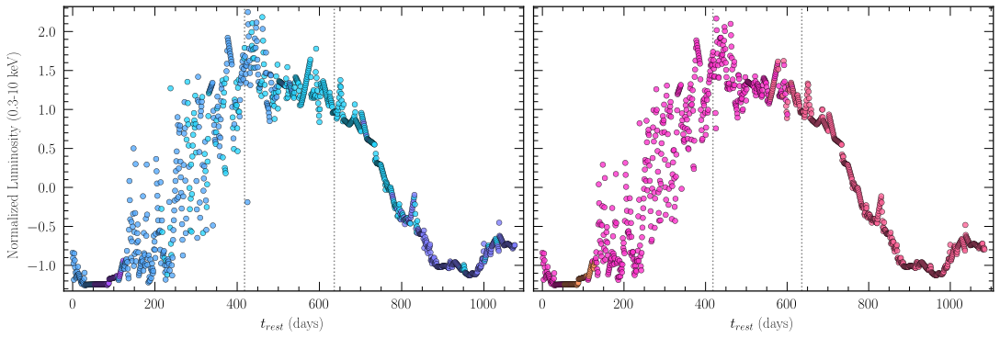

In [147]:
# color lightcurve by greedy communities

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 5), sharey='row')

for ax in axes:
    for day in [418, 636]:
        ax.axvline(day, color='grey', linestyle=":", zorder=1)

axes[0].scatter(df['time'].values[:len(node_colors)], df['scaled lumin'].values[:len(node_colors)], facecolor=node_colors, alpha=0.8, zorder=3, edgecolor='k', s=35, linewidths=0.5)  # alpha is for transparency
axes[1].scatter(pred_df['time'].values[:len(dho_node_colors)], pred_df['lumin'].values[:len(dho_node_colors)], facecolor=dho_node_colors, alpha=0.8, zorder=3, edgecolor='k', s=35, linewidths=0.5)  # alpha is for transparency
axes[1].tick_params(which="both", axis="y", labelleft=False)

axes[0].set_ylabel('Normalized Luminosity (0.3-10 keV)') 
for ax in axes: ax.set_xlabel(r'$t_{rest}$ (days)')

plt.savefig('../plots/1ES_lc_greedy_modularity_communities.pdf', bbox_inches='tight')
plt.show()

In [161]:

# Partition the graph into communities
communities = nx.algorithms.community.greedy_modularity_communities(G) #nxg)
dho_communities = nx.algorithms.community.greedy_modularity_communities(DHO_G) #_nxg)

# Get the unique colors from the "cool" colormap for each community
cmap = sns.color_palette("cool", n_colors=len(communities))
dho_cmap = sns.color_palette("spring", n_colors=len(dho_communities))

# Initialize the dictionaries to hold the mapping from nodes to colors
node_colors_mapping = {}
dho_node_colors_mapping = {}

# Assign a color to each node based on community membership
for community_id, community in enumerate(communities):
    for node in community:
        node_colors_mapping[node] = cmap[community_id]

for community_id, community in enumerate(dho_communities):
    for node in community:
        dho_node_colors_mapping[node] = dho_cmap[community_id]

# Get the colors for each node in the graph in the order of the nodes
node_colors = [node_colors_mapping[node] for node in G.nodes()]
dho_node_colors = [dho_node_colors_mapping[node] for node in DHO_G.nodes()]

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

titles = ['1ES 1927+654', 'Best-Fit DHO Prediction']

node_sizes = list(dict(G.degree()).values())
graph_plot_options = {
    "node_size": [n * 0.5 for n in node_sizes],
    "node_color": node_colors,
    "linewidths": 0.5 #[0.5 for i in range(len(G))] 

}

dho_node_sizes = list(dict(DHO_G.degree()).values())
dho_graph_plot_options = {
    "node_size": [n * 0.5 for n in dho_node_sizes],
    "node_color": dho_node_colors,
    "linewidths": 0.5 #[0.5 for i in range(len(DHO_G))]

}

# pos_kamada = nx.kamada_kawai_layout(G)
scaled_pos_kamada = nx.rescale_layout_dict(pos_kamada)
# dho_pos_kamada = nx.kamada_kawai_layout(DHO_G)
scaled_dho_pos_kamada = nx.rescale_layout_dict(dho_pos_kamada)

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos_kamada, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos_kamada, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].axis('off') 

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos_kamada, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos_kamada, **dho_graph_plot_options,alpha=1, edgecolors=['black']*len(dho_node_colors))
axes[1].axis('off') 

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_kamada_kawai_modularity_communities.pdf", bbox_inches='tight')
plt.show()  

/var/folders/1t/cw_9qncx42l90j4kknls85g80000gn/T/ipykernel_73442/87208819.py:68: UserWarning: The figure layout has changed to tight
  plt.tight_layout()# Or save to a file if preferred


In [ ]:

# Partition the graph into communities
partition = community_louvain.best_partition(G)
inverted_partition = {}
for node, community_id in partition.items():
    if community_id not in inverted_partition: inverted_partition[community_id] = [node]
    else: inverted_partition[community_id].append(node)
     
dho_partition = community_louvain.best_partition(DHO_G)
dho_inverted_partition = {}
for node, community_id in dho_partition.items():
    if community_id not in dho_inverted_partition: dho_inverted_partition[community_id] = [node]
    else: dho_inverted_partition[community_id].append(node)
     
# Initialize the dictionaries to hold the mapping from nodes to colors
node_colors_mapping = {}
dho_node_colors_mapping = {}

# Assign a color to each node based on community membership
for community_id, nodes in inverted_partition.items():
    for node in nodes:
        node_colors_mapping[node] = cmap[community_id % len(cmap)]  # Modulo to avoid index out of range

for community_id, nodes in dho_inverted_partition.items():
    for node in nodes:
        dho_node_colors_mapping[node] = dho_cmap[community_id % len(dho_cmap)]  # Modulo to avoid index out of range

# Convert color mappings to lists to use with networkx drawing functions
node_colors = [node_colors_mapping.get(node) for node in G.nodes()]
dho_node_colors = [dho_node_colors_mapping.get(node) for node in DHO_G.nodes()]


titles = ['1ES 1927+654', 'Best-Fit DHO Prediction']

graph_plot_options = {
    "node_size": node_sizes,
    "node_color": node_colors,
    "linewidths": 0.5
}

dho_graph_plot_options = {
    "node_size": dho_node_sizes,
    "node_color": dho_node_colors, 
    "linewidths": 0.5
}

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].axis('off') 

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos, **dho_graph_plot_options, alpha=1, edgecolors=['black']*len(dho_colors))
axes[1].axis('off')

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_spring_layout_louvain_communities.pdf", bbox_inches='tight')
plt.show()  



In [ ]:

# Partition the graph into communities
partition = community_louvain.best_partition(G)
inverted_partition = {}
for node, community_id in partition.items():
    if community_id not in inverted_partition: inverted_partition[community_id] = [node]
    else: inverted_partition[community_id].append(node)
     
dho_partition = community_louvain.best_partition(DHO_G)
dho_inverted_partition = {}
for node, community_id in dho_partition.items():
    if community_id not in dho_inverted_partition: dho_inverted_partition[community_id] = [node]
    else: dho_inverted_partition[community_id].append(node)
     
# Initialize the dictionaries to hold the mapping from nodes to colors
node_colors_mapping = {}
dho_node_colors_mapping = {}

# Assign a color to each node based on community membership
for community_id, nodes in inverted_partition.items():
    for node in nodes:
        node_colors_mapping[node] = cmap[community_id % len(cmap)]  # Modulo to avoid index out of range

for community_id, nodes in dho_inverted_partition.items():
    for node in nodes:
        dho_node_colors_mapping[node] = dho_cmap[community_id % len(dho_cmap)]  # Modulo to avoid index out of range

# Convert color mappings to lists to use with networkx drawing functions
node_colors = [node_colors_mapping.get(node) for node in G.nodes()]
dho_node_colors = [dho_node_colors_mapping.get(node) for node in DHO_G.nodes()]


titles = ['1ES 1927+654', 'Best-Fit DHO Prediction']

graph_plot_options = {
    "node_size": node_sizes,
    "node_color": node_colors,
    "linewidths": 0.5
}

dho_graph_plot_options = {
    "node_size": dho_node_sizes,
    "node_color": dho_node_colors, 
    "linewidths": 0.5
}

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos_kamada, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos_kamada, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].axis('off') 

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos_kamada, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos_kamada, **dho_graph_plot_options, alpha=1, edgecolors=['black']*len(dho_colors))
axes[1].axis('off')

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_kamada_kawai_louvain_communities.pdf", bbox_inches='tight')
plt.show()  

In [ ]:
pos_spring_time = nx.spring_layout(G)
scaled_pos_time = nx.rescale_layout_dict(pos_spring_time)
dho_pos_spring_time = nx.spring_layout(DHO_G)
scaled_dho_pos_time = nx.rescale_layout_dict(dho_pos_spring_time)

# adjust x position to be node number (i.e. ordered by time)
for i, node in enumerate(scaled_pos_time):
    scaled_pos_time[node][0] = i  
    scaled_dho_pos_time[node][0] = i

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

# Original data plot
nx.draw_networkx_edges(G, ax=axes[0], pos=scaled_pos_time, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(G, ax=axes[0], pos=scaled_pos_time, **graph_plot_options, alpha=1, edgecolors=['black']*len(node_colors))
axes[0].axis('off') 

# DHO predicted data plot
nx.draw_networkx_edges(DHO_G, ax=axes[1], pos=scaled_dho_pos_time, alpha=0.05, edge_color='midnightblue')
nx.draw_networkx_nodes(DHO_G, ax=axes[1], pos=scaled_dho_pos_time, **dho_graph_plot_options, alpha=1, edgecolors=['black']*len(dho_colors))
axes[1].axis('off') 

plt.tight_layout()
plt.savefig("../plots/1ES_compare_DHO_spring_layout_louvain_communities_time-ordered.pdf", bbox_inches='tight')
plt.show()  

